# Import

In [1]:
import numpy as np
import pandas as pd
import seaborn as sns
import matplotlib.pyplot as plt
from sklearn.manifold import TSNE

In [2]:
train = pd.read_csv("train.csv")
test = pd.read_csv("test.csv")

In [3]:
train.head()

,state,account_length,area_code,international_plan,voice_mail_plan,number_vmail_messages,total_day_minutes,total_day_calls,total_day_charge,total_eve_minutes,total_eve_calls,total_eve_charge,total_night_minutes,total_night_calls,total_night_charge,total_intl_minutes,total_intl_calls,total_intl_charge,number_customer_service_calls,churn
0,OH,107,area_code_415,no,yes,26,161.6,123,27.47,195.5,103,16.62,254.4,103,11.45,13.7,3,3.70,1,no
1,NJ,137,area_code_415,no,no,0,243.4,114,41.38,121.2,110,10.30,162.6,104,7.32,12.2,5,3.29,0,no
2,OH,84,area_code_408,yes,no,0,299.4,71,50.90,61.9,88,5.26,196.9,89,8.86,6.6,7,1.78,2,no
3,OK,75,area_code_415,yes,no,0,166.7,113,28.34,148.3,122,12.61,186.9,121,8.41,10.1,3,2.73,3,no
4,MA,121,area_code_510,no,yes,24,218.2,88,37.09,348.5,108,29.62,212.6,118,9.57,7.5,7,2.03,3,no


In [4]:
shape_train = train.shape

In [5]:
test.head()

,id,state,account_length,area_code,international_plan,voice_mail_plan,number_vmail_messages,total_day_minutes,total_day_calls,total_day_charge,total_eve_minutes,total_eve_calls,total_eve_charge,total_night_minutes,total_night_calls,total_night_charge,total_intl_minutes,total_intl_calls,total_intl_charge,number_customer_service_calls
0,1,KS,128,area_code_415,no,yes,25,265.1,110,45.07,197.4,99,16.78,244.7,91,11.01,10.0,3,2.70,1
1,2,AL,118,area_code_510,yes,no,0,223.4,98,37.98,220.6,101,18.75,203.9,118,9.18,6.3,6,1.70,0
2,3,IA,62,area_code_415,no,no,0,120.7,70,20.52,307.2,76,26.11,203.0,99,9.14,13.1,6,3.54,4
3,4,VT,93,area_code_510,no,no,0,190.7,114,32.42,218.2,111,18.55,129.6,121,5.83,8.1,3,2.19,3
4,5,NE,174,area_code_415,no,no,0,124.3,76,21.13,277.1,112,23.55,250.7,115,11.28,15.5,5,4.19,3


In [6]:
shape_test = test.shape

In [7]:
data = pd.concat([train,test[test.columns.difference(['id'])]],axis = 0)
data.head()

,state,account_length,area_code,international_plan,voice_mail_plan,number_vmail_messages,total_day_minutes,total_day_calls,total_day_charge,total_eve_minutes,total_eve_calls,total_eve_charge,total_night_minutes,total_night_calls,total_night_charge,total_intl_minutes,total_intl_calls,total_intl_charge,number_customer_service_calls,churn
0,OH,107,area_code_415,no,yes,26,161.6,123,27.47,195.5,103,16.62,254.4,103,11.45,13.7,3,3.70,1,no
1,NJ,137,area_code_415,no,no,0,243.4,114,41.38,121.2,110,10.30,162.6,104,7.32,12.2,5,3.29,0,no
2,OH,84,area_code_408,yes,no,0,299.4,71,50.90,61.9,88,5.26,196.9,89,8.86,6.6,7,1.78,2,no
3,OK,75,area_code_415,yes,no,0,166.7,113,28.34,148.3,122,12.61,186.9,121,8.41,10.1,3,2.73,3,no
4,MA,121,area_code_510,no,yes,24,218.2,88,37.09,348.5,108,29.62,212.6,118,9.57,7.5,7,2.03,3,no


In [8]:
data.isna().sum()

state                              0
account_length                     0
area_code                          0
international_plan                 0
voice_mail_plan                    0
number_vmail_messages              0
total_day_minutes                  0
total_day_calls                    0
total_day_charge                   0
total_eve_minutes                  0
total_eve_calls                    0
total_eve_charge                   0
total_night_minutes                0
total_night_calls                  0
total_night_charge                 0
total_intl_minutes                 0
total_intl_calls                   0
total_intl_charge                  0
number_customer_service_calls      0
churn                            750
dtype: int64

# EDA

C:\Users\lette\anaconda3\lib\site-packages\seaborn\_decorators.py:43: FutureWarning: Pass the following variable as a keyword arg: x. From version 0.12, the only valid positional argument will be `data`, and passing other arguments without an explicit keyword will result in an error or misinterpretation.
  FutureWarning


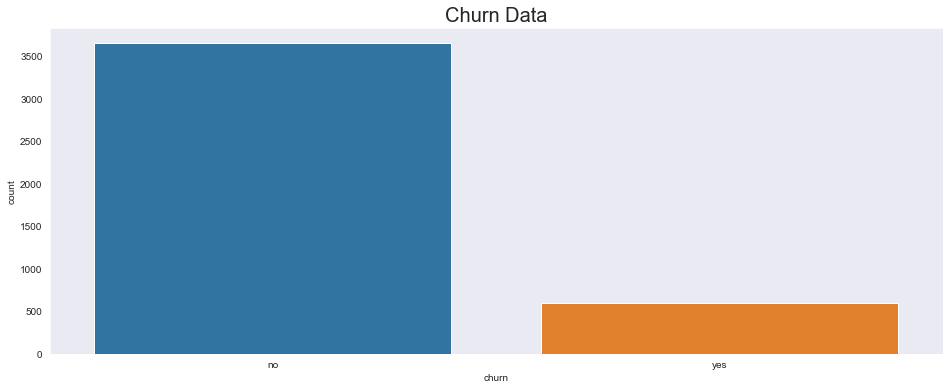

In [24]:
sns.set_style("dark")
plt.figure(figsize=(16, 6))
sns.countplot(data['churn']);
plt.title("Churn Data", size = 20)
plt.show()

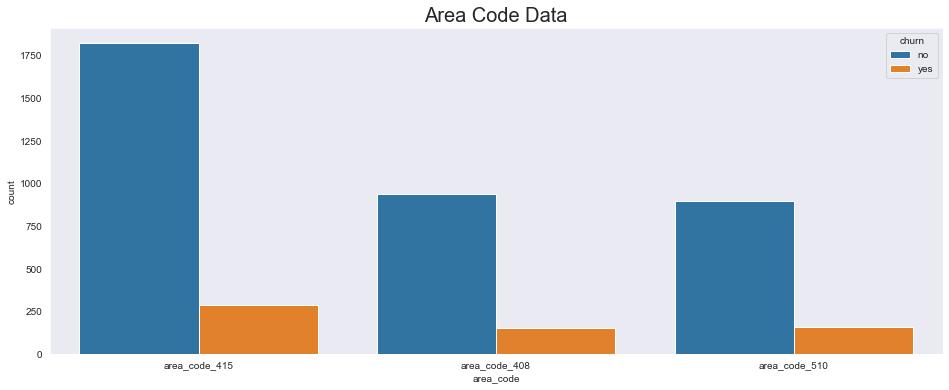

In [23]:
sns.set_style("dark")
plt.figure(figsize=(16, 6))
sns.countplot(data = data, x = 'area_code',hue = 'churn');
plt.title("Area Code Data", size = 20)
plt.show()

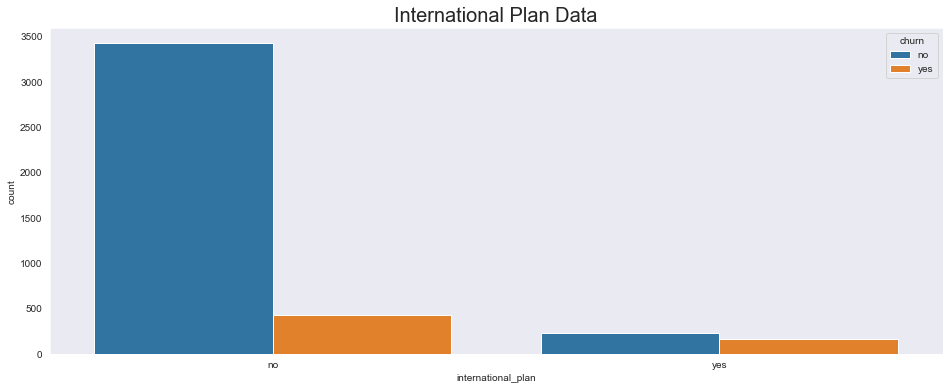

In [25]:
sns.set_style("dark")
plt.figure(figsize=(16, 6))
sns.countplot(data = data, x = 'international_plan',hue = 'churn');
plt.title("International Plan Data", size = 20)
plt.show()

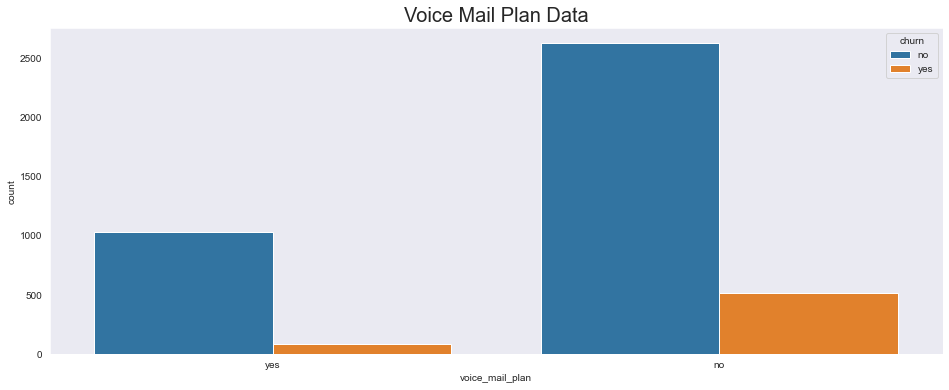

In [26]:
sns.set_style("dark")
plt.figure(figsize=(16, 6))
sns.countplot(data = data, x = 'voice_mail_plan',hue = 'churn');
plt.title("Voice Mail Plan Data", size = 20)
plt.show()

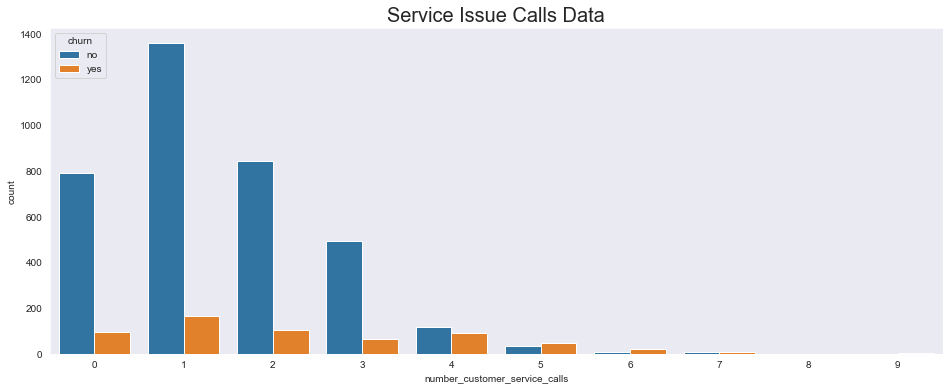

In [28]:
sns.set_style("dark")
plt.figure(figsize=(16, 6))
sns.countplot(data = data, x = 'number_customer_service_calls',hue = 'churn');
plt.title("Service Issue Calls Data", size = 20)
plt.show()

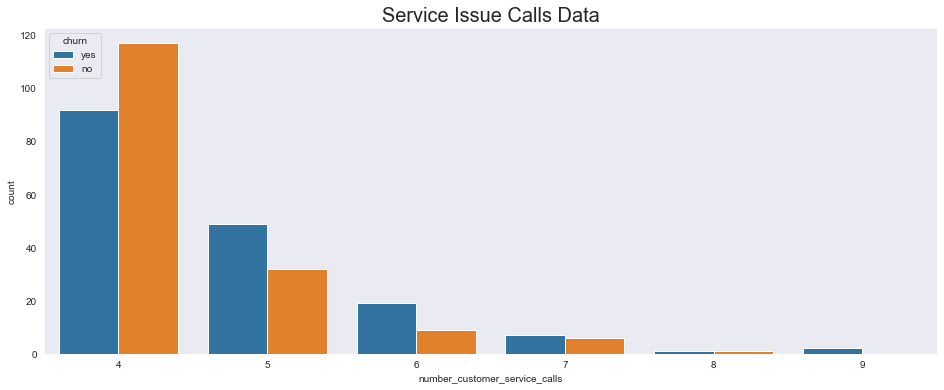

In [33]:
sns.set_style("dark")
plt.figure(figsize=(16, 6))
sns.countplot(data = data[data.number_customer_service_calls>3], x = 'number_customer_service_calls',hue = 'churn');
plt.title("Service Issue Calls Data", size = 20)
plt.show()

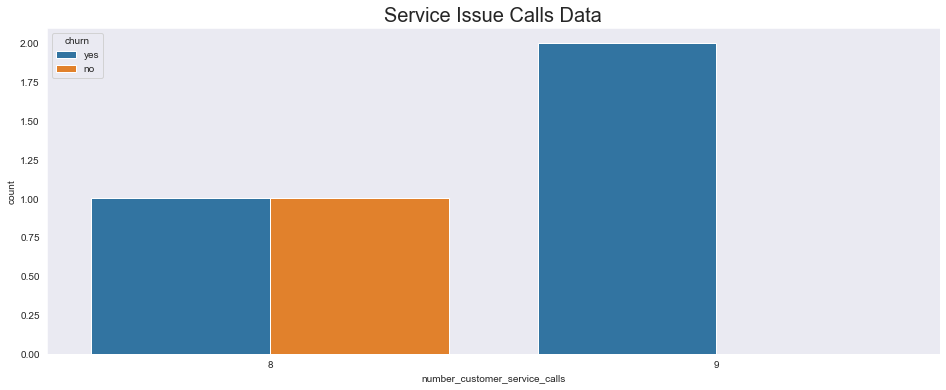

In [35]:
sns.set_style("dark")
plt.figure(figsize=(16, 6))
sns.countplot(data = data[data.number_customer_service_calls>7], x = 'number_customer_service_calls',hue = 'churn');
plt.title("Service Issue Calls Data", size = 20)
plt.show()

In [111]:
# As per the trend, the more the users call the customer care, the more they end up churning
data.reset_index(inplace=True)
data['churn'].replace(to_replace='yes',value=1,inplace=True)
data['churn'].replace(to_replace='no',value=0,inplace=True)

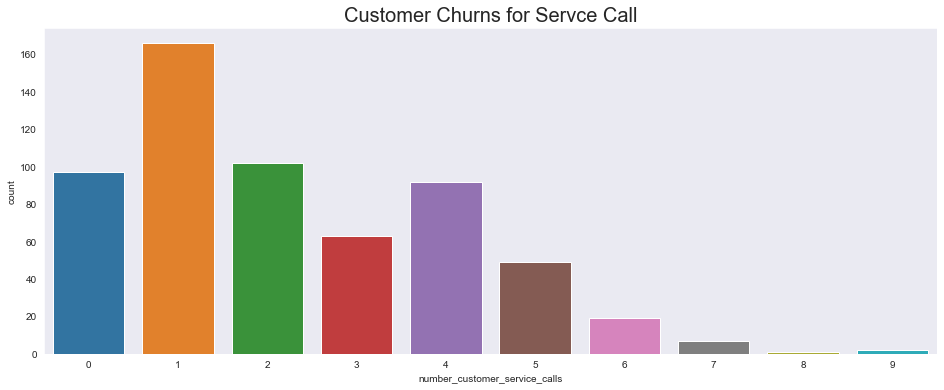

In [42]:
sns.set_style("dark")
plt.figure(figsize=(16, 6))
sns.countplot(data = data[data.churn==1], x = 'number_customer_service_calls')#,hue = 'churn');
plt.title("Customer Churns for Servce Call", size = 20)
plt.show()

In [43]:
data.columns

Index(['state', 'account_length', 'area_code', 'international_plan',
       'voice_mail_plan', 'number_vmail_messages', 'total_day_minutes',
       'total_day_calls', 'total_day_charge', 'total_eve_minutes',
       'total_eve_calls', 'total_eve_charge', 'total_night_minutes',
       'total_night_calls', 'total_night_charge', 'total_intl_minutes',
       'total_intl_calls', 'total_intl_charge',
       'number_customer_service_calls', 'churn', 'from', 'id'],
      dtype='object')

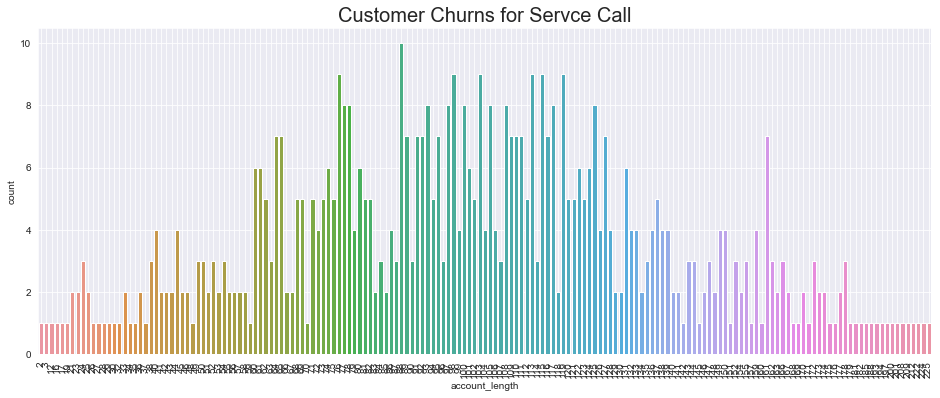

In [51]:
sns.set_style("dark")
plt.figure(figsize=(16, 6))
sns.countplot(data = data[data.churn==1], x = 'account_length')#,hue = 'churn');
plt.grid()
plt.xticks(rotation=90)
plt.title("Customer Churns for Servce Call", size = 20)
plt.show()

In [52]:
# We could see that the customers  around the mean churn more often, then the newer or older users

In [60]:
data.describe().T

,count,mean,std,min,25%,50%,75%,max
account_length,5000.0,100.258600,39.694560,1.0,73.000,100.00,127.00,243.00
number_vmail_messages,5000.0,7.755200,13.546393,0.0,0.000,0.00,17.00,52.00
total_day_minutes,5000.0,180.288900,53.894699,0.0,143.700,180.10,216.20,351.50
total_day_calls,5000.0,100.029400,19.831197,0.0,87.000,100.00,113.00,165.00
total_day_charge,5000.0,30.649668,9.162069,0.0,24.430,30.62,36.75,59.76
total_eve_minutes,5000.0,200.636560,50.551309,0.0,166.375,201.00,234.10,363.70
total_eve_calls,5000.0,100.191000,19.826496,0.0,87.000,100.00,114.00,170.00
total_eve_charge,5000.0,17.054322,4.296843,0.0,14.140,17.09,19.90,30.91
total_night_minutes,5000.0,200.391620,50.527789,0.0,166.900,200.40,234.70,395.00
total_night_calls,5000.0,99.919200,19.958686,0.0,87.000,100.00,113.00,175.00


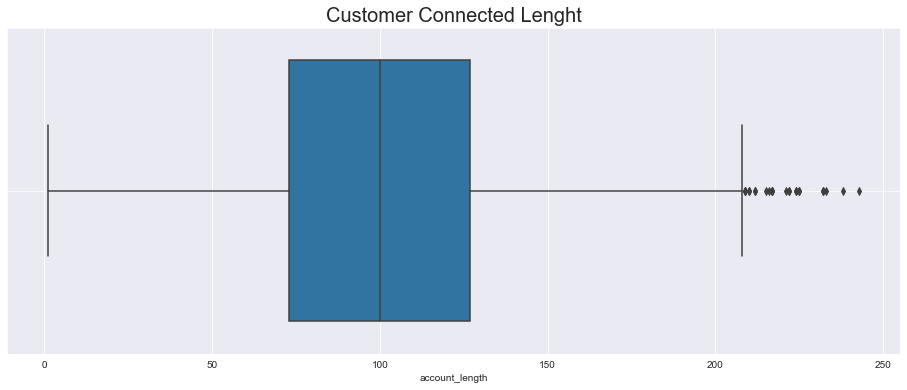

In [66]:
sns.set_style("dark")
plt.figure(figsize=(16, 6))
ax = sns.boxplot(x="account_length",data=data,hue="churn")
plt.grid()
plt.title("Customer Connected Lenght", size = 20)
plt.show()

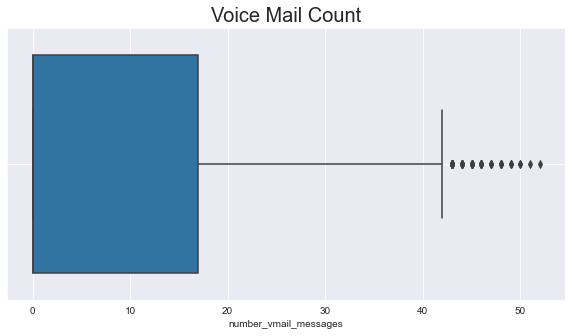

In [68]:
sns.set_style("dark")
plt.figure(figsize=(10, 5))
ax = sns.boxplot(x="number_vmail_messages",data=data,hue="churn")
plt.grid()
plt.title("Voice Mail Count", size = 20)
plt.show()

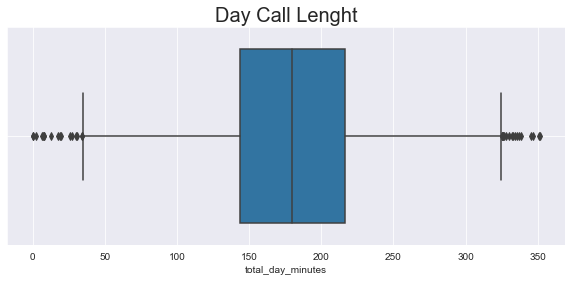

In [70]:
sns.set_style("dark")
plt.figure(figsize=(10, 4))
ax = sns.boxplot(x="total_day_minutes",data=data,hue="churn")
plt.grid()
plt.title("Day Call Lenght", size = 20)
plt.show()

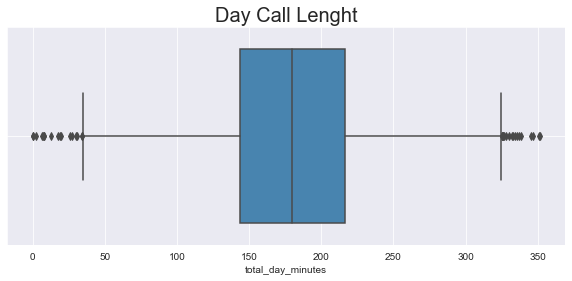

In [53]:
sns.set_style("dark")
plt.figure(figsize=(10, 4))
ax = sns.boxplot(x="total_day_minutes",data=data,hue="churn",palette="Blues_d")
plt.grid()
plt.title("Day Call Lenght", size = 20)
plt.show()

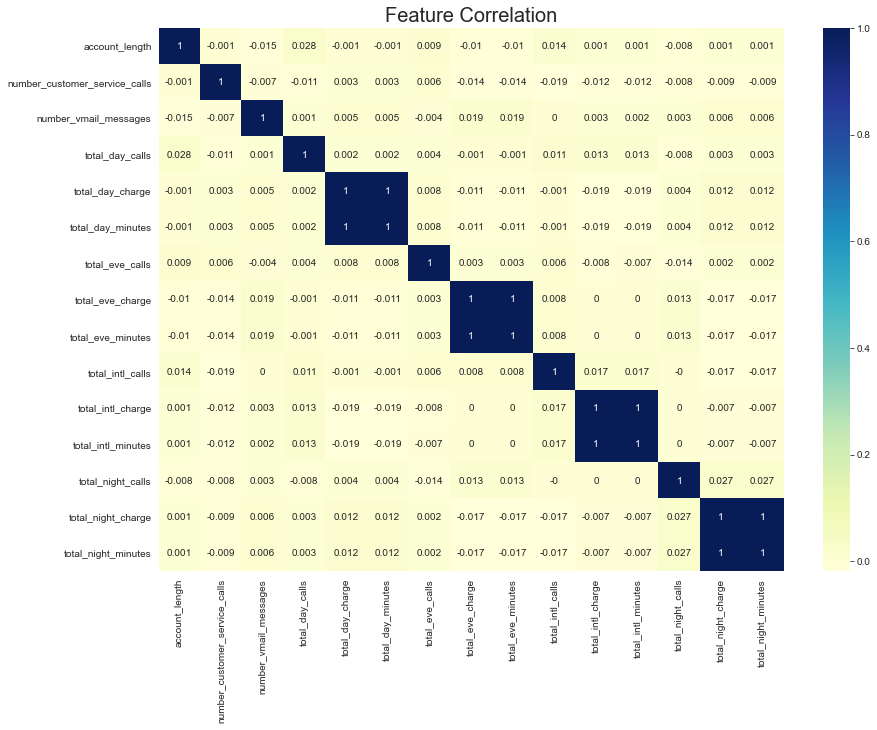

In [27]:
# Let us check the correlation among the features
def create_conrr(mat):
    sns.set_style("dark")
    plt.figure(figsize=(14, 10))
    ax = sns.heatmap(mat.corr().round(3), annot=True,cmap="YlGnBu")
    plt.grid()
    plt.title("Feature Correlation", size = 20)
    plt.show()
create_conrr(data[data.columns.difference(['churn','from','id','area_code'])])

C:\Users\lette\anaconda3\lib\site-packages\seaborn\_decorators.py:43: FutureWarning: Pass the following variable as a keyword arg: x. From version 0.12, the only valid positional argument will be `data`, and passing other arguments without an explicit keyword will result in an error or misinterpretation.
  FutureWarning


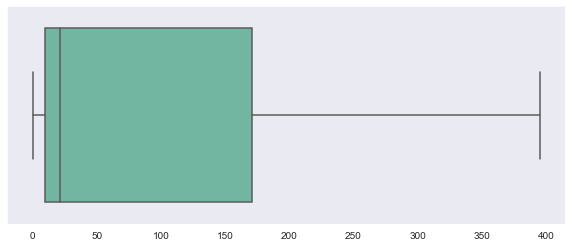

In [71]:
# We could see that Total Charge and Total Minutes are Highly correlated
sns.set_style("dark")
plt.figure(figsize=(10, 4))
ax = sns.boxplot(data[['total_day_minutes','total_day_charge', 'total_eve_minutes','total_eve_charge', 'total_night_minutes','total_night_charge', 'total_intl_minutes','total_intl_charge']].values,palette="Set2",hue=data.churn)

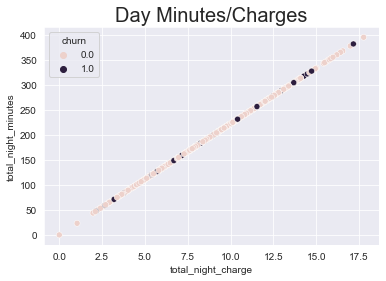

In [54]:
sns.set_style("dark")
plt.figure(figsize=(6, 4))
sns.scatterplot(data=data,x = 'total_night_charge',y='total_night_minutes',hue='churn')
plt.grid()
plt.title("Day Minutes/Charges", size = 20)
plt.show()

In [15]:
def normalize(df):
    result = df.copy()
    for feature_name in df.columns:
        max_value = df[feature_name].max()
        min_value = df[feature_name].min()
        result[feature_name] = (df[feature_name] - min_value) / (max_value - min_value)
    return result

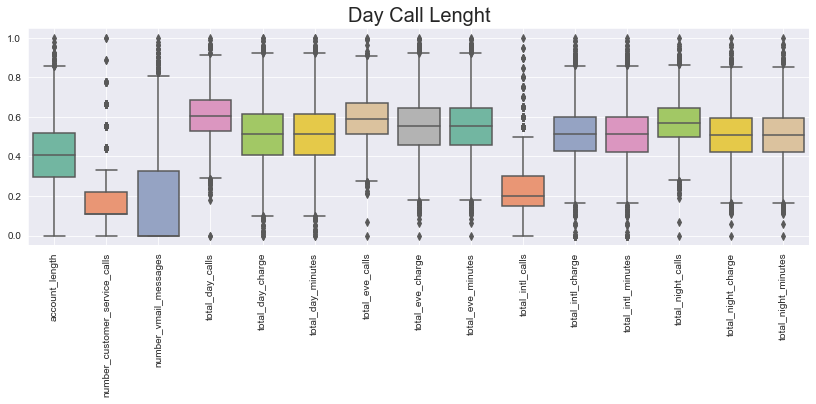

In [118]:
sns.set_style("dark")
plt.figure(figsize=(14, 4))
ax = sns.boxplot(data=normalize(data[data.columns.difference(['churn','from','id','area_code','international_plan','state','voice_mail_plan'])]),palette="Set2")
plt.grid()
plt.xticks(rotation=90)
plt.title("Day Call Lenght", size = 20)
plt.show()

In [98]:
data.head()

,state,account_length,area_code,international_plan,voice_mail_plan,number_vmail_messages,total_day_minutes,total_day_calls,total_day_charge,total_eve_minutes,...,total_night_minutes,total_night_calls,total_night_charge,total_intl_minutes,total_intl_calls,total_intl_charge,number_customer_service_calls,churn,from,id
0,OH,107,area_code_415,no,yes,26,161.6,123,27.47,195.5,...,254.4,103,11.45,13.7,3,3.70,1,0.0,Train,NaN
1,NJ,137,area_code_415,no,no,0,243.4,114,41.38,121.2,...,162.6,104,7.32,12.2,5,3.29,0,0.0,Train,NaN
2,OH,84,area_code_408,yes,no,0,299.4,71,50.90,61.9,...,196.9,89,8.86,6.6,7,1.78,2,0.0,Train,NaN
3,OK,75,area_code_415,yes,no,0,166.7,113,28.34,148.3,...,186.9,121,8.41,10.1,3,2.73,3,0.0,Train,NaN
4,MA,121,area_code_510,no,yes,24,218.2,88,37.09,348.5,...,212.6,118,9.57,7.5,7,2.03,3,0.0,Train,NaN


In [102]:
data.columns

Index(['state', 'account_length', 'area_code', 'international_plan',
       'voice_mail_plan', 'number_vmail_messages', 'total_day_minutes',
       'total_day_calls', 'total_day_charge', 'total_eve_minutes',
       'total_eve_calls', 'total_eve_charge', 'total_night_minutes',
       'total_night_calls', 'total_night_charge', 'total_intl_minutes',
       'total_intl_calls', 'total_intl_charge',
       'number_customer_service_calls', 'churn', 'from', 'id'],
      dtype='object')

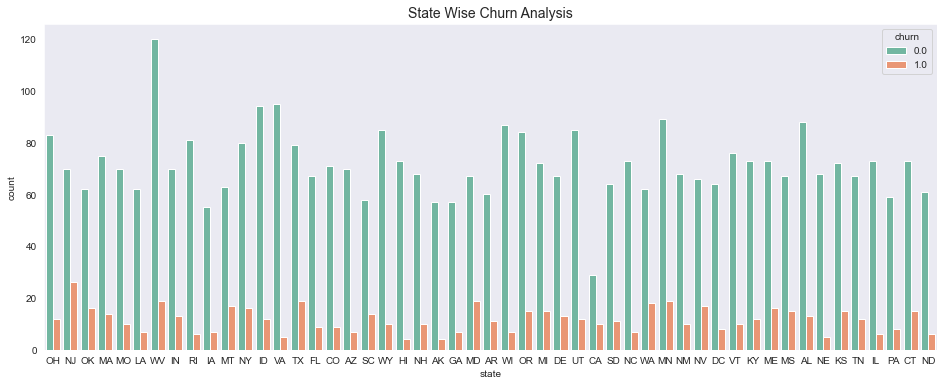

In [113]:
sns.set_style("dark")
plt.figure(figsize=(16, 6))
sns.countplot(data = data, x = 'state',hue = 'churn',palette="Set2");
plt.title("State Wise Churn Analysis", size = 14)
plt.show()

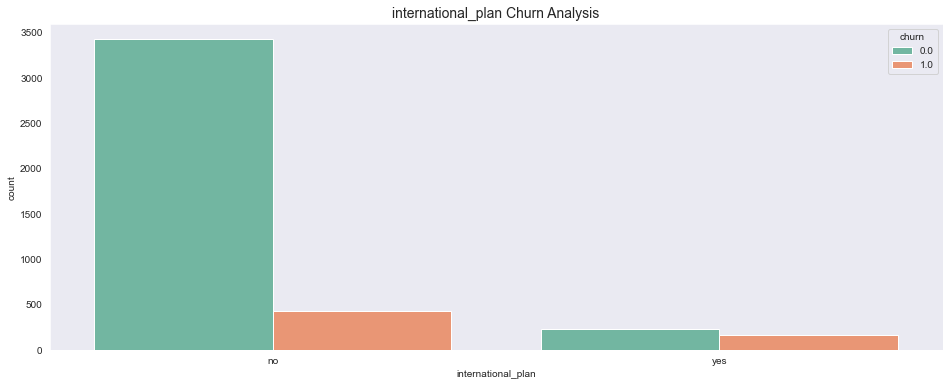

In [112]:
sns.set_style("dark")
plt.figure(figsize=(16, 6))
sns.countplot(data = data, x = 'international_plan',hue = 'churn',palette="Set2");
plt.title("international_plan Churn Analysis", size = 14)
plt.show()

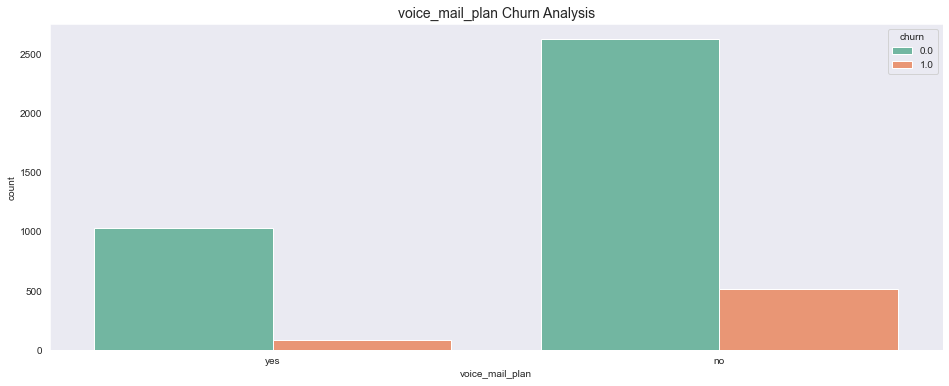

In [111]:
sns.set_style("dark")
plt.figure(figsize=(16, 6))
sns.countplot(data = data, x = 'voice_mail_plan',hue = 'churn',palette="Set2");
plt.title("voice_mail_plan Churn Analysis", size = 14)
plt.show()

In [34]:
# Removing Outliers
# Outlier Observation Analysis
"""data.reset_index(inplace=True)
cols = data[data.columns.difference(['churn','from','id','area_code','international_plan','state','voice_mail_plan'])].columns
def outlier_remmoval(data):    
    Q1 = data.quantile(0.15)
    Q3 = data.quantile(0.85)
    IQR = Q3-Q1
    lower = Q1- 1.5*IQR
    upper = Q3 + 1.5*IQR
    data = data.loc[~((data < lower) |(data > upper)).any(axis = 1)]
    return data
data = outlier_remmoval(data)"""

"data.reset_index(inplace=True)\ncols = data[data.columns.difference(['churn','from','id','area_code','international_plan','state','voice_mail_plan'])].columns\ndef outlier_remmoval(data):    \n    Q1 = data.quantile(0.15)\n    Q3 = data.quantile(0.85)\n    IQR = Q3-Q1\n    lower = Q1- 1.5*IQR\n    upper = Q3 + 1.5*IQR\n    data = data.loc[~((data < lower) |(data > upper)).any(axis = 1)]\n    return data\ndata = outlier_remmoval(data)"

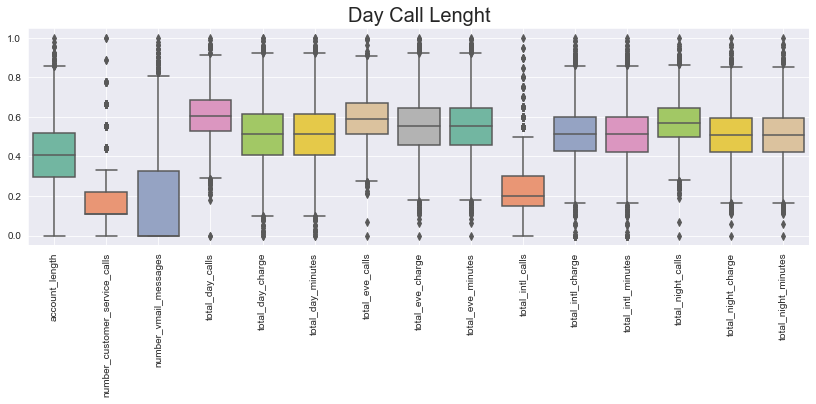

In [33]:
sns.set_style("dark")
plt.figure(figsize=(14, 4))
sns.boxplot(data=normalize(data[data.columns.difference(['churn','from','id','area_code','international_plan','state','voice_mail_plan'])]),palette="Set2")
plt.grid()
plt.xticks(rotation=90)
plt.title("Day Call Lenght", size = 20)
plt.show()

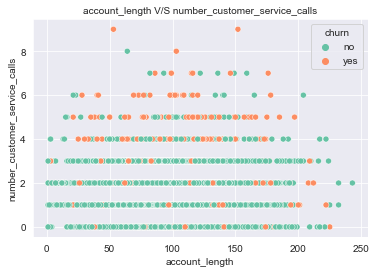

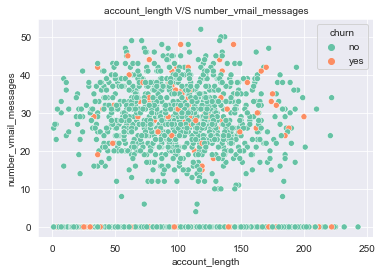

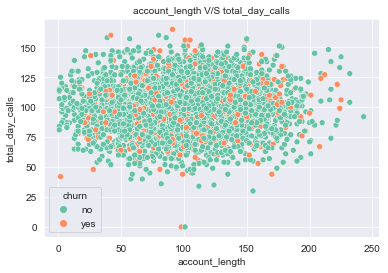

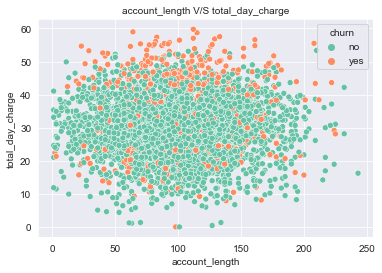

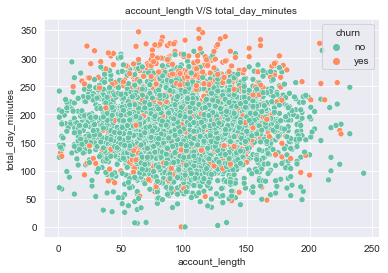

...

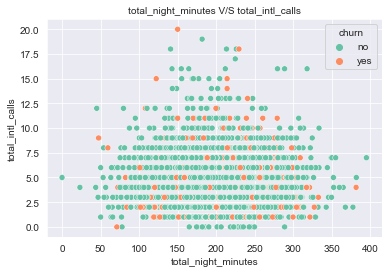

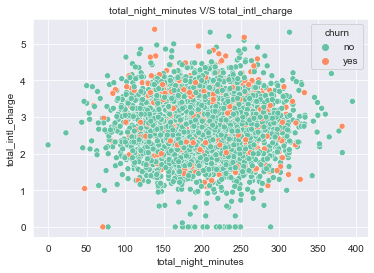

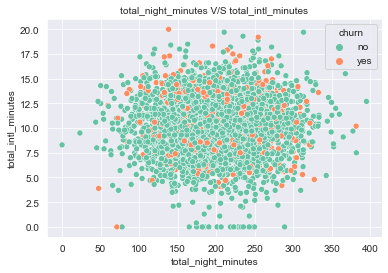

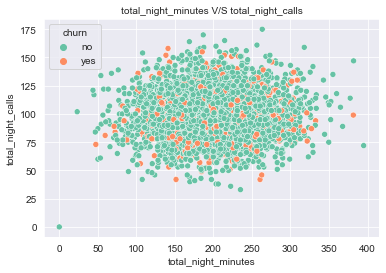

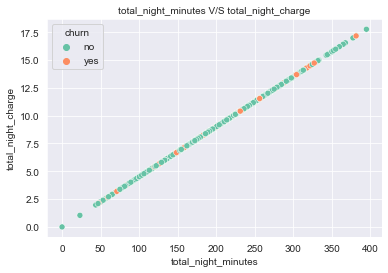

In [38]:
cols = data[data.columns.difference(['churn','from','id','area_code','international_plan','state','voice_mail_plan'])].columns
for i in cols:
    for j in cols:
        if i != j:
            sns.set_style("dark")
            plt.figure(figsize=(6, 4))
            sns.scatterplot(data = data,x=i,y=j,palette="Set2",hue = "churn")
            plt.grid()
            plt.title(i +" V/S "+ j, size = 10)
            plt.show()

C:\Users\lette\anaconda3\lib\site-packages\seaborn\axisgrid.py:316: UserWarning: The `size` parameter has been renamed to `height`; please update your code.
  warnings.warn(msg, UserWarning)


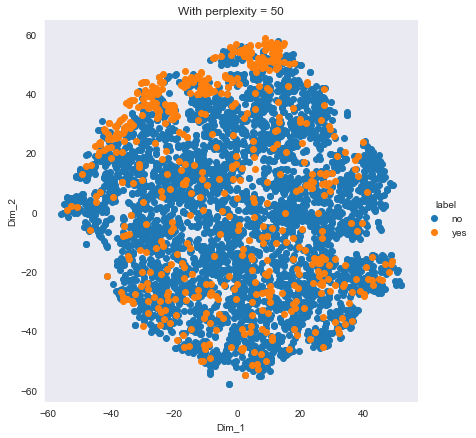

In [46]:
# We could see that the trains are not well seperable
# Lets try to visualize this by TSNE
labels = train['churn'].values
model = TSNE(n_components=2, random_state=0, perplexity=50)
tsne_train = model.fit_transform(train[train.columns.difference(['churn','from','id','area_code','international_plan','state','voice_mail_plan'])]) 
# creating a new train fram which help us in ploting the result train
tsne_train = np.vstack((tsne_train.T, labels)).T  # Stacking rows into columns [Depends upon the train for its dimention]
tsne_df = pd.DataFrame(data=tsne_train, columns=("Dim_1", "Dim_2", "label"))
# Ploting the result of tsne
sns.FacetGrid(tsne_df, hue="label", size=6).map(plt.scatter, 'Dim_1', 'Dim_2').add_legend()
plt.title('With perplexity = 50')
plt.show()

C:\Users\lette\anaconda3\lib\site-packages\seaborn\axisgrid.py:316: UserWarning: The `size` parameter has been renamed to `height`; please update your code.
  warnings.warn(msg, UserWarning)


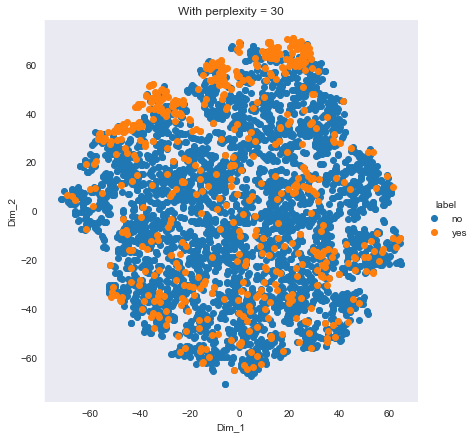

In [47]:
# We could see that the trains are not well seperable
# Lets try to visualize this by TSNE
labels = train['churn'].values
model = TSNE(n_components=2, random_state=0, perplexity=30)
tsne_train = model.fit_transform(train[train.columns.difference(['churn','from','id','area_code','international_plan','state','voice_mail_plan'])]) 
# creating a new train fram which help us in ploting the result train
tsne_train = np.vstack((tsne_train.T, labels)).T  # Stacking rows into columns [Depends upon the train for its dimention]
tsne_df = pd.DataFrame(data=tsne_train, columns=("Dim_1", "Dim_2", "label"))
# Ploting the result of tsne
sns.FacetGrid(tsne_df, hue="label", size=6).map(plt.scatter, 'Dim_1', 'Dim_2').add_legend()
plt.title('With perplexity = 30')
plt.show()

C:\Users\lette\anaconda3\lib\site-packages\seaborn\axisgrid.py:316: UserWarning: The `size` parameter has been renamed to `height`; please update your code.
  warnings.warn(msg, UserWarning)


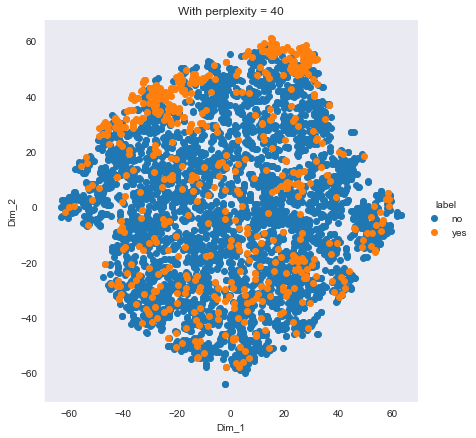

In [48]:
# We could see that the trains are not well seperable
# Lets try to visualize this by TSNE
labels = train['churn'].values
model = TSNE(n_components=2, random_state=0, perplexity=40)
tsne_train = model.fit_transform(train[train.columns.difference(['churn','from','id','area_code','international_plan','state','voice_mail_plan'])]) 
# creating a new train fram which help us in ploting the result train
tsne_train = np.vstack((tsne_train.T, labels)).T  # Stacking rows into columns [Depends upon the train for its dimention]
tsne_df = pd.DataFrame(data=tsne_train, columns=("Dim_1", "Dim_2", "label"))
# Ploting the result of tsne
sns.FacetGrid(tsne_df, hue="label", size=6).map(plt.scatter, 'Dim_1', 'Dim_2').add_legend()
plt.title('With perplexity = 40')
plt.show()

C:\Users\lette\anaconda3\lib\site-packages\seaborn\axisgrid.py:316: UserWarning: The `size` parameter has been renamed to `height`; please update your code.
  warnings.warn(msg, UserWarning)


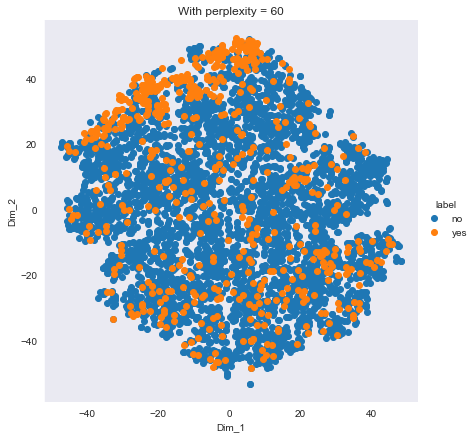

In [49]:
# We could see that the trains are not well seperable
# Lets try to visualize this by TSNE
labels = train['churn'].values
model = TSNE(n_components=2, random_state=0, perplexity=60)
tsne_train = model.fit_transform(train[train.columns.difference(['churn','from','id','area_code','international_plan','state','voice_mail_plan'])]) 
# creating a new train fram which help us in ploting the result train
tsne_train = np.vstack((tsne_train.T, labels)).T  # Stacking rows into columns [Depends upon the train for its dimention]
tsne_df = pd.DataFrame(data=tsne_train, columns=("Dim_1", "Dim_2", "label"))
# Ploting the result of tsne
sns.FacetGrid(tsne_df, hue="label", size=6).map(plt.scatter, 'Dim_1', 'Dim_2').add_legend()
plt.title('With perplexity = 60')
plt.show()

C:\Users\lette\anaconda3\lib\site-packages\seaborn\axisgrid.py:316: UserWarning: The `size` parameter has been renamed to `height`; please update your code.
  warnings.warn(msg, UserWarning)


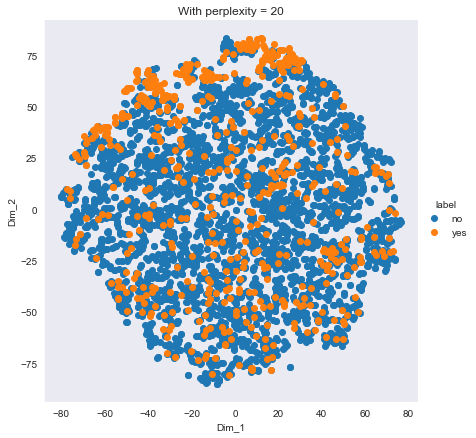

In [50]:
# We could see that the trains are not well seperable
# Lets try to visualize this by TSNE
labels = train['churn'].values
model = TSNE(n_components=2, random_state=0, perplexity=20)
tsne_train = model.fit_transform(train[train.columns.difference(['churn','from','id','area_code','international_plan','state','voice_mail_plan'])]) 
# creating a new train fram which help us in ploting the result train
tsne_train = np.vstack((tsne_train.T, labels)).T  # Stacking rows into columns [Depends upon the train for its dimention]
tsne_df = pd.DataFrame(data=tsne_train, columns=("Dim_1", "Dim_2", "label"))
# Ploting the result of tsne
sns.FacetGrid(tsne_df, hue="label", size=6).map(plt.scatter, 'Dim_1', 'Dim_2').add_legend()
plt.title('With perplexity = 20')
plt.show()

At lower perplexity we can easily separate the data.

# Modeling

In [9]:
from sklearn.naive_bayes import GaussianNB
from sklearn.model_selection import train_test_split
from sklearn.preprocessing import MinMaxScaler
from sklearn.metrics import precision_score, recall_score, accuracy_score
from sklearn.metrics import log_loss
from sklearn.metrics import f1_score
from sklearn.metrics import confusion_matrix
from sklearn import metrics
from sklearn.metrics import roc_curve, auc
from sklearn.metrics import classification_report
from sklearn.linear_model import SGDClassifier
from sklearn.model_selection import GridSearchCV
from sklearn.neighbors import KNeighborsClassifier
from sklearn.ensemble import RandomForestClassifier
from yellowbrick.classifier import roc_auc

C:\Users\lette\anaconda3\lib\site-packages\sklearn\utils\deprecation.py:143: FutureWarning: The sklearn.metrics.classification module is  deprecated in version 0.22 and will be removed in version 0.24. The corresponding classes / functions should instead be imported from sklearn.metrics. Anything that cannot be imported from sklearn.metrics is now part of the private API.
  warnings.warn(message, FutureWarning)


In [10]:
data['churn'].replace(to_replace='yes',value=1,inplace=True)
data['churn'].replace(to_replace='no',value=0,inplace=True)
data.columns

Index(['state', 'account_length', 'area_code', 'international_plan',
       'voice_mail_plan', 'number_vmail_messages', 'total_day_minutes',
       'total_day_calls', 'total_day_charge', 'total_eve_minutes',
       'total_eve_calls', 'total_eve_charge', 'total_night_minutes',
       'total_night_calls', 'total_night_charge', 'total_intl_minutes',
       'total_intl_calls', 'total_intl_charge',
       'number_customer_service_calls', 'churn'],
      dtype='object')

In [11]:
data.dtypes

state                             object
account_length                     int64
area_code                         object
international_plan                object
voice_mail_plan                   object
number_vmail_messages              int64
total_day_minutes                float64
total_day_calls                    int64
total_day_charge                 float64
total_eve_minutes                float64
total_eve_calls                    int64
total_eve_charge                 float64
total_night_minutes              float64
total_night_calls                  int64
total_night_charge               float64
total_intl_minutes               float64
total_intl_calls                   int64
total_intl_charge                float64
number_customer_service_calls      int64
churn                            float64
dtype: object

In [12]:
cols = ['account_length','number_vmail_messages', 'total_day_minutes','total_day_calls', 'total_day_charge', 'total_eve_minutes','total_eve_calls', 'total_eve_charge', 'total_night_minutes','total_night_calls', 'total_night_charge', 'total_intl_minutes','total_intl_calls', 'total_intl_charge']
# create a scaler object
scaler = MinMaxScaler()
# fit and transform the data
data[cols] = pd.DataFrame(scaler.fit_transform(data[cols]), columns=cols)

In [13]:
# We would try to create a baseline model
data = pd.get_dummies(data,columns=['state','area_code','international_plan','voice_mail_plan','number_customer_service_calls'])
data.head()

,account_length,number_vmail_messages,total_day_minutes,total_day_calls,total_day_charge,total_eve_minutes,total_eve_calls,total_eve_charge,total_night_minutes,total_night_calls,...,number_customer_service_calls_0,number_customer_service_calls_1,number_customer_service_calls_2,number_customer_service_calls_3,number_customer_service_calls_4,number_customer_service_calls_5,number_customer_service_calls_6,number_customer_service_calls_7,number_customer_service_calls_8,number_customer_service_calls_9
0,0.438017,0.500000,0.459744,0.745455,0.459672,0.537531,0.605882,0.537690,0.644051,0.588571,...,0,1,0,0,0,0,0,0,0,0
1,0.561983,0.000000,0.692461,0.690909,0.692436,0.333242,0.647059,0.333225,0.411646,0.594286,...,1,0,0,0,0,0,0,0,0,0
2,0.342975,0.000000,0.851778,0.430303,0.851740,0.170195,0.517647,0.170171,0.498481,0.508571,...,0,0,1,0,0,0,0,0,0,0
3,0.305785,0.000000,0.474253,0.684848,0.474230,0.407754,0.717647,0.407959,0.473165,0.691429,...,0,0,0,1,0,0,0,0,0,0
4,0.495868,0.461538,0.620768,0.533333,0.620649,0.958207,0.635294,0.958266,0.538228,0.674286,...,0,0,0,1,0,0,0,0,0,0


In [34]:
y = data['churn'].iloc[:shape_train[0]]
data.pop('churn')
X = data.copy()

In [14]:
# This function will provide result to oour classification model
def validate_result(y_true, y_pred,model="Model"):
    print(f"The Result for the {model} Classification is a Below\n")
    conf = confusion_matrix(y_true, y_pred)
    b = sns.heatmap(conf, cmap="YlGnBu",annot=True)
    b.axes.set_title("Confusion Matrix",fontsize=20)
    b.set_xlabel("Predicted Value",fontsize=16)
    b.set_ylabel("True Value",fontsize=16)
    b.tick_params(labelsize=16)
    print("=="*50)
    print(f"Recall Score: {(recall_score(y_true, y_pred)*100).round(3)} %")
    print(f"Precision Score: {(precision_score(y_true, y_pred)*100).round(3)} %")
    print("F1 Score: ",f1_score(y_true, y_pred))
    print("Log Loss: ",log_loss(y_true, y_pred).round(4))
    print(f'Accuracy Score: {(accuracy_score(y_true, y_pred)*100).round(3)} %')
    report = classification_report(y_true, y_pred, output_dict=True)
    df = pd.DataFrame(report).transpose()
    print("Classification Report:\n",df)
    print("\n")
    print("Confusion Matrix:\n",conf)

In [36]:
X = data[:shape_train[0]]
X_test = data[shape_train[0]:]
X_train, X_cv, y_train, y_cv = train_test_split(X, y, test_size=0.33, random_state=42)

The Result for the GaussianNB Classification is a Below

Recall Score: 25.472 %
Precision Score: 57.447 %
F1 Score:  0.3529411764705882
Log Loss:  4.8743
Accuracy Score: 85.887 %
Classification Report:
               precision    recall  f1-score      support
0.0            0.879297  0.966415  0.920800  1191.000000
1.0            0.574468  0.254717  0.352941   212.000000
accuracy       0.858874  0.858874  0.858874     0.858874
macro avg      0.726883  0.610566  0.636871  1403.000000
weighted avg   0.833236  0.858874  0.834994  1403.000000


Confusion Matrix:
 [[1151   40]
 [ 158   54]]


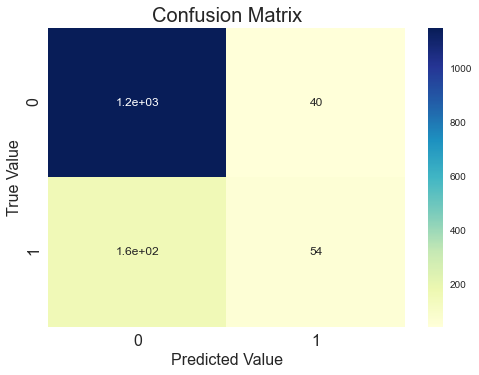

In [62]:
clf = GaussianNB()
clf.fit(X_train,y_train)
validate_result(y_cv,clf.predict(X_cv),model="GaussianNB")

C:\Users\lette\anaconda3\lib\site-packages\sklearn\base.py:213: FutureWarning: From version 0.24, get_params will raise an AttributeError if a parameter cannot be retrieved as an instance attribute. Previously it would return None.
  FutureWarning)


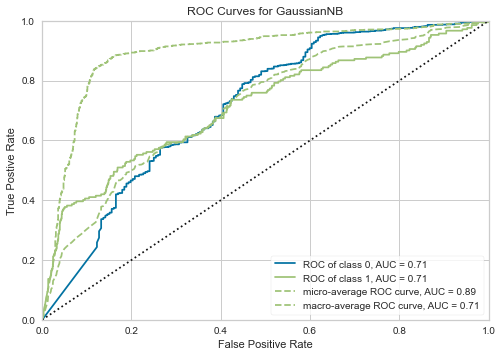

C:\Users\lette\anaconda3\lib\site-packages\sklearn\base.py:213: FutureWarning: From version 0.24, get_params will raise an AttributeError if a parameter cannot be retrieved as an instance attribute. Previously it would return None.
  FutureWarning)


ROCAUC(ax=<AxesSubplot:title={'center':'ROC Curves for GaussianNB'}, xlabel='False Positive Rate', ylabel='True Postive Rate'>,
       classes=[0, 1], model=None)

In [64]:
roc_auc(GaussianNB(),X_train,y_train,X_test = X_cv, y_test = y_cv,classes=[0,1])

The Result for the SGD Log Loss Classification is a Below

Recall Score: 61.792 %
Precision Score: 52.4 %
F1 Score:  0.5670995670995671
Log Loss:  4.9236
Accuracy Score: 85.745 %
Classification Report:
               precision    recall  f1-score      support
0.0            0.929748  0.900084  0.914676  1191.000000
1.0            0.524000  0.617925  0.567100   212.000000
accuracy       0.857448  0.857448  0.857448     0.857448
macro avg      0.726874  0.759004  0.740888  1403.000000
weighted avg   0.868438  0.857448  0.862155  1403.000000


Confusion Matrix:
 [[1072  119]
 [  81  131]]


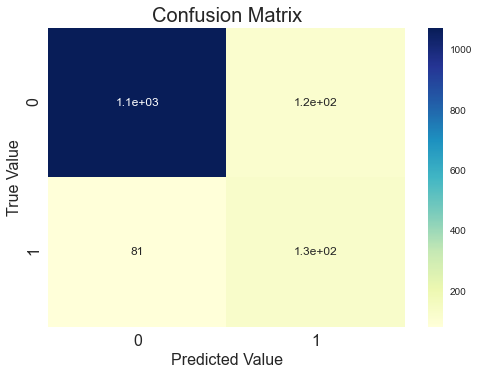

In [65]:
# Let us try with SGDClassifier for Logistic Regression, with GridSearch
param = {'penalty':['l1','l2','elasticnet'],'alpha':[0.0001,0.001,0.01,0.1,1,10],'epsilon':[0.001,0.01,0.1,1]}
sgd_sear = SGDClassifier(loss='log')
clf = GridSearchCV(sgd_sear,param,scoring='accuracy')
clf.fit(X_train,y_train)
best_log = clf.best_estimator_
best_log.fit(X_train,y_train)
validate_result(y_cv,best_log.predict(X_cv),model="SGD Log Loss")

C:\Users\lette\anaconda3\lib\site-packages\sklearn\base.py:213: FutureWarning: From version 0.24, get_params will raise an AttributeError if a parameter cannot be retrieved as an instance attribute. Previously it would return None.
  FutureWarning)


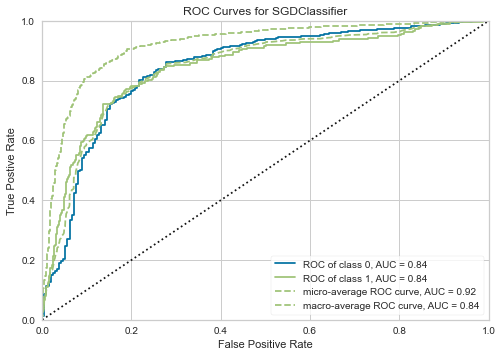

C:\Users\lette\anaconda3\lib\site-packages\sklearn\base.py:213: FutureWarning: From version 0.24, get_params will raise an AttributeError if a parameter cannot be retrieved as an instance attribute. Previously it would return None.
  FutureWarning)


ROCAUC(ax=<AxesSubplot:title={'center':'ROC Curves for SGDClassifier'}, xlabel='False Positive Rate', ylabel='True Postive Rate'>,
       classes=[0, 1], model=None)

In [66]:
roc_auc(clf.best_estimator_,X_train,y_train,X_test = X_cv, y_test = y_cv,classes=[0,1])

The Result for the SGD SVM Loss Classification is a Below

Recall Score: 10.849 %
Precision Score: 62.162 %
F1 Score:  0.1847389558232932
Log Loss:  4.9974
Accuracy Score: 85.531 %
Classification Report:
               precision    recall  f1-score     support
0.0            0.861640  0.988245  0.920610  1191.00000
1.0            0.621622  0.108491  0.184739   212.00000
accuracy       0.855310  0.855310  0.855310     0.85531
macro avg      0.741631  0.548368  0.552675  1403.00000
weighted avg   0.825372  0.855310  0.809416  1403.00000


Confusion Matrix:
 [[1177   14]
 [ 189   23]]


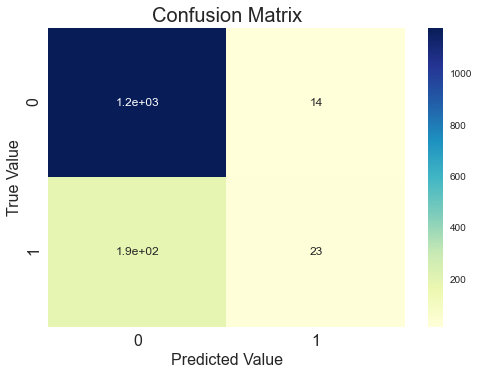

In [67]:
# Let us try with SGDClassifier for SVM Regression, with GridSearch
param = {'penalty':['l1','l2','elasticnet'],'alpha':[0.0001,0.001,0.01,0.1,1,10],'epsilon':[0.001,0.01,0.1,1]}
sgd_sear = SGDClassifier(loss='hinge')
clf = GridSearchCV(sgd_sear,param,scoring='accuracy')
clf.fit(X_train,y_train)
best_log = clf.best_estimator_
best_log.fit(X_train,y_train)
validate_result(y_cv,best_log.predict(X_cv),model="SGD SVM Loss")

The Result for the KNN Classification is a Below

Recall Score: 15.094 %
Precision Score: 76.19 %
F1 Score:  0.25196850393700787
Log Loss:  4.6774
Accuracy Score: 86.458 %
Classification Report:
               precision    recall  f1-score      support
0.0            0.867744  0.991604  0.925549  1191.000000
1.0            0.761905  0.150943  0.251969   212.000000
accuracy       0.864576  0.864576  0.864576     0.864576
macro avg      0.814825  0.571274  0.588759  1403.000000
weighted avg   0.851751  0.864576  0.823767  1403.000000


Confusion Matrix:
 [[1181   10]
 [ 180   32]]
Best Parameters:  {'algorithm': 'auto', 'n_neighbors': 9, 'weights': 'uniform'}


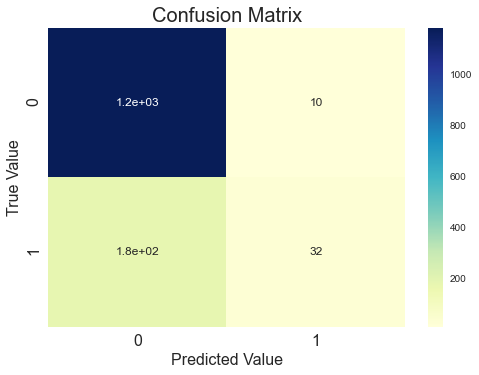

In [69]:
# Lets see how KNN gives us result
# Let us try with SGDClassifier for SVM Regression, with GridSearch
param = {'n_neighbors':[3,5,7,9,11,13],'weights':['uniform','distance'],'algorithm':['auto', 'ball_tree', 'kd_tree', 'brute']}
sgd_sear = KNeighborsClassifier()
clf = GridSearchCV(sgd_sear,param,scoring='accuracy')
clf.fit(X_train,y_train)
best_log = clf.best_estimator_
best_log.fit(X_train,y_train)
validate_result(y_cv,best_log.predict(X_cv),model="KNN")
print("Best Parameters: ",clf.best_params_)

C:\Users\lette\anaconda3\lib\site-packages\sklearn\base.py:213: FutureWarning: From version 0.24, get_params will raise an AttributeError if a parameter cannot be retrieved as an instance attribute. Previously it would return None.
  FutureWarning)


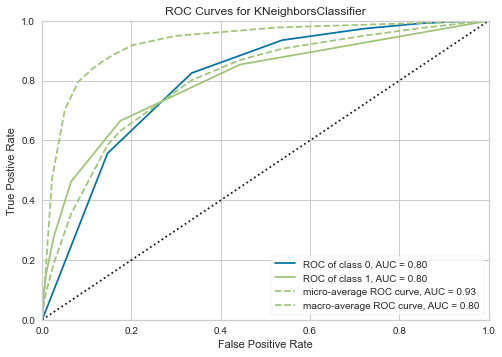

C:\Users\lette\anaconda3\lib\site-packages\sklearn\base.py:213: FutureWarning: From version 0.24, get_params will raise an AttributeError if a parameter cannot be retrieved as an instance attribute. Previously it would return None.
  FutureWarning)


ROCAUC(ax=<AxesSubplot:title={'center':'ROC Curves for KNeighborsClassifier'}, xlabel='False Positive Rate', ylabel='True Postive Rate'>,
       classes=[0, 1], model=None)

In [70]:
roc_auc(clf.best_estimator_,X_train,y_train,X_test = X_cv, y_test = y_cv,classes=[0,1])

The Result for the Random Forest Classification is a Below

Recall Score: 66.981 %
Precision Score: 97.26 %
F1 Score:  0.7932960893854747
Log Loss:  1.8217
Accuracy Score: 94.726 %
Classification Report:
               precision    recall  f1-score      support
0.0            0.944312  0.996641  0.969771  1191.000000
1.0            0.972603  0.669811  0.793296   212.000000
accuracy       0.947256  0.947256  0.947256     0.947256
macro avg      0.958457  0.833226  0.881534  1403.000000
weighted avg   0.948587  0.947256  0.943105  1403.000000


Confusion Matrix:
 [[1187    4]
 [  70  142]]
Best Parameters:  {'criterion': 'gini', 'max_depth': 17, 'n_estimators': 130}


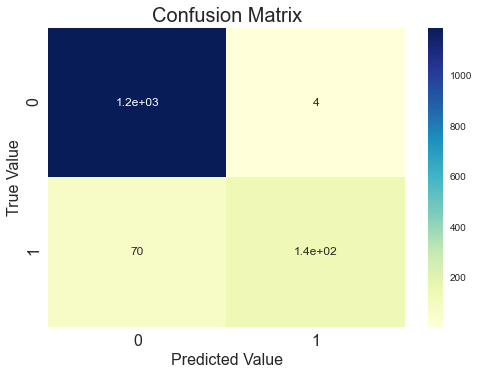

In [71]:
# Let us try random forest 
param = {'n_estimators':[30,50,70,100,130,150,170,200,230,250],
         'criterion':['entropy','gini'],
        'max_depth':[3,5,7,9,11,13,15,17,20]}
sgd_sear = RandomForestClassifier()
clf = GridSearchCV(sgd_sear,param,scoring='accuracy')
clf.fit(X_train,y_train)
best_log = clf.best_estimator_
best_log.fit(X_train,y_train)
validate_result(y_cv,best_log.predict(X_cv),model="Random Forest")
print("Best Parameters: ",clf.best_params_)

C:\Users\lette\anaconda3\lib\site-packages\sklearn\base.py:213: FutureWarning: From version 0.24, get_params will raise an AttributeError if a parameter cannot be retrieved as an instance attribute. Previously it would return None.
  FutureWarning)


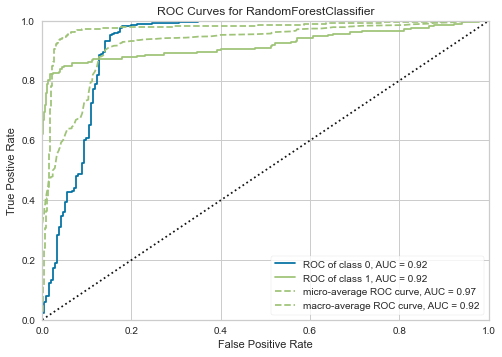

C:\Users\lette\anaconda3\lib\site-packages\sklearn\base.py:213: FutureWarning: From version 0.24, get_params will raise an AttributeError if a parameter cannot be retrieved as an instance attribute. Previously it would return None.
  FutureWarning)


ROCAUC(ax=<AxesSubplot:title={'center':'ROC Curves for RandomForestClassifier'}, xlabel='False Positive Rate', ylabel='True Postive Rate'>,
       classes=[0, 1], model=None)

In [72]:
roc_auc(clf.best_estimator_,X_train,y_train,X_test = X_cv, y_test = y_cv,classes=[0,1])

The Result for the Decision Tree Forest Classification is a Below

Recall Score: 74.057 %
Precision Score: 80.513 %
F1 Score:  0.7714987714987714
Log Loss:  2.2895
Accuracy Score: 93.371 %
Classification Report:
               precision    recall  f1-score      support
0.0            0.954470  0.968094  0.961234  1191.000000
1.0            0.805128  0.740566  0.771499   212.000000
accuracy       0.933713  0.933713  0.933713     0.933713
macro avg      0.879799  0.854330  0.866366  1403.000000
weighted avg   0.931904  0.933713  0.932564  1403.000000


Confusion Matrix:
 [[1153   38]
 [  55  157]]
Best Parameters:  {'criterion': 'entropy', 'max_depth': 9}


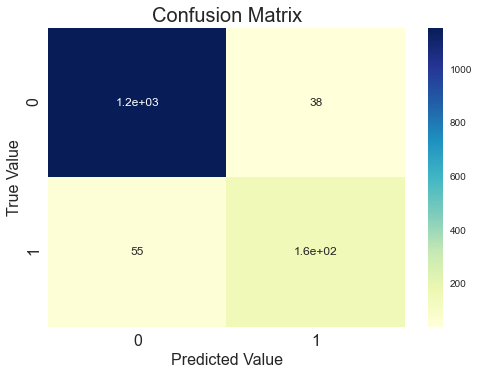

In [73]:
from sklearn.tree import DecisionTreeClassifier
# Let us try random forest 
param = {'criterion':['entropy','gini'],
        'max_depth':[3,5,7,9,11,13,15,17,20]}
sgd_sear = DecisionTreeClassifier()
clf = GridSearchCV(sgd_sear,param,scoring='accuracy')
clf.fit(X_train,y_train)
best_log = clf.best_estimator_
best_log.fit(X_train,y_train)
validate_result(y_cv,best_log.predict(X_cv),model="Decision Tree Forest")
print("Best Parameters: ",clf.best_params_)

C:\Users\lette\anaconda3\lib\site-packages\sklearn\base.py:213: FutureWarning: From version 0.24, get_params will raise an AttributeError if a parameter cannot be retrieved as an instance attribute. Previously it would return None.
  FutureWarning)


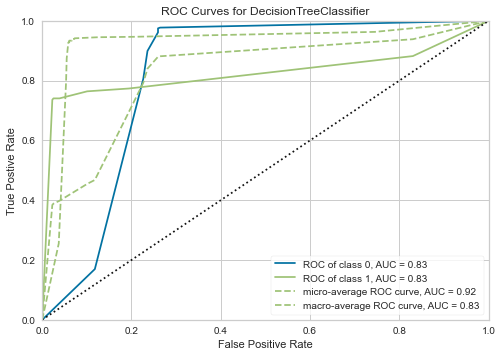

C:\Users\lette\anaconda3\lib\site-packages\sklearn\base.py:213: FutureWarning: From version 0.24, get_params will raise an AttributeError if a parameter cannot be retrieved as an instance attribute. Previously it would return None.
  FutureWarning)


ROCAUC(ax=<AxesSubplot:title={'center':'ROC Curves for DecisionTreeClassifier'}, xlabel='False Positive Rate', ylabel='True Postive Rate'>,
       classes=[0, 1], model=None)

In [74]:
roc_auc(clf.best_estimator_,X_train,y_train,X_test = X_cv, y_test = y_cv,classes=[0,1])

Tree based algorithm is providing much better results

In [17]:
# As we know that total minuites and total charges are highly colinear, hence lets try to remove one of them
# and see how our results look

y = data['churn'].iloc[:shape_train[0]]
data.pop('churn')
X = data.copy()

X = data[:shape_train[0]]
X.drop(['total_day_minutes','total_eve_minutes','total_night_minutes','total_intl_minutes'],axis=1, inplace=True)
X_test = data[shape_train[0]:]
X_test.drop(['total_day_minutes','total_eve_minutes','total_night_minutes','total_intl_minutes'],axis=1, inplace=True)
X_train, X_cv, y_train, y_cv = train_test_split(X, y, test_size=0.33, random_state=42)

C:\Users\lette\anaconda3\lib\site-packages\pandas\core\frame.py:4169: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  errors=errors,


The Result for the Decision Tree Forest Classification is a Below

Recall Score: 74.057 %
Precision Score: 82.199 %
F1 Score:  0.7791563275434243
Log Loss:  2.191
Accuracy Score: 93.656 %
Classification Report:
               precision    recall  f1-score      support
0.0            0.954620  0.971453  0.962963  1191.000000
1.0            0.821990  0.740566  0.779156   212.000000
accuracy       0.936565  0.936565  0.936565     0.936565
macro avg      0.888305  0.856009  0.871060  1403.000000
weighted avg   0.934579  0.936565  0.935189  1403.000000


Confusion Matrix:
 [[1157   34]
 [  55  157]]
Best Parameters:  {'criterion': 'entropy', 'max_depth': 9}


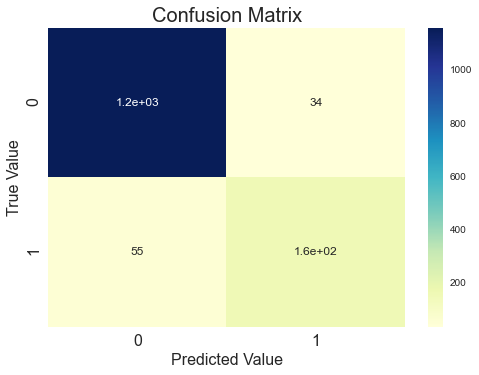

In [18]:
# As Tree based algorithm has provided better results, we would try to see if our model performance improves

from sklearn.tree import DecisionTreeClassifier
# Let us try random forest 
param = {'criterion':['entropy','gini'],
        'max_depth':[3,5,7,9,11,13,15,17,20]}
sgd_sear = DecisionTreeClassifier()
clf = GridSearchCV(sgd_sear,param,scoring='accuracy')
clf.fit(X_train,y_train)
best_log = clf.best_estimator_
best_log.fit(X_train,y_train)
validate_result(y_cv,best_log.predict(X_cv),model="Decision Tree Forest")
print("Best Parameters: ",clf.best_params_)

C:\Users\lette\anaconda3\lib\site-packages\sklearn\base.py:213: FutureWarning: From version 0.24, get_params will raise an AttributeError if a parameter cannot be retrieved as an instance attribute. Previously it would return None.
  FutureWarning)


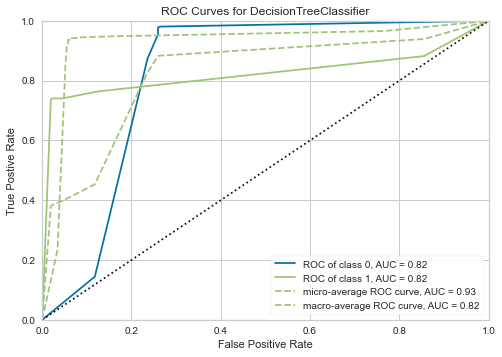

C:\Users\lette\anaconda3\lib\site-packages\sklearn\base.py:213: FutureWarning: From version 0.24, get_params will raise an AttributeError if a parameter cannot be retrieved as an instance attribute. Previously it would return None.
  FutureWarning)


ROCAUC(ax=<AxesSubplot:title={'center':'ROC Curves for DecisionTreeClassifier'}, xlabel='False Positive Rate', ylabel='True Postive Rate'>,
       classes=[0, 1], model=None)

In [19]:
roc_auc(clf.best_estimator_,X_train,y_train,X_test = X_cv, y_test = y_cv,classes=[0,1])

The Result for the Random Forest Classification is a Below

Recall Score: 53.774 %
Precision Score: 96.61 %
F1 Score:  0.6909090909090908
Log Loss:  2.511
Accuracy Score: 92.73 %
Classification Report:
               precision    recall  f1-score      support
0.0            0.923735  0.996641  0.958805  1191.000000
1.0            0.966102  0.537736  0.690909   212.000000
accuracy       0.927299  0.927299  0.927299     0.927299
macro avg      0.944919  0.767189  0.824857  1403.000000
weighted avg   0.930137  0.927299  0.918324  1403.000000


Confusion Matrix:
 [[1187    4]
 [  98  114]]
Best Parameters:  {'criterion': 'entropy', 'max_depth': 20, 'n_estimators': 170}


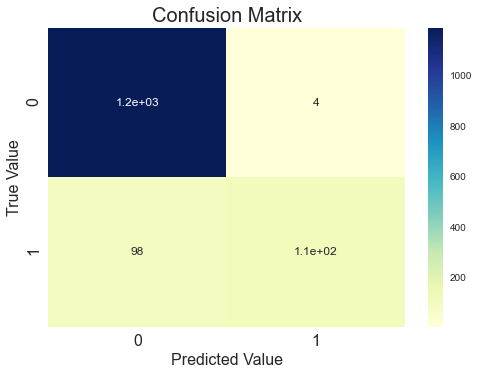

In [20]:
# Let us try random forest 
param = {'n_estimators':[30,50,70,100,130,150,170,200,230,250],
         'criterion':['entropy','gini'],
        'max_depth':[3,5,7,9,11,13,15,17,20]}
sgd_sear = RandomForestClassifier()
clf = GridSearchCV(sgd_sear,param,scoring='accuracy')
clf.fit(X_train,y_train)
best_log = clf.best_estimator_
best_log.fit(X_train,y_train)
validate_result(y_cv,best_log.predict(X_cv),model="Random Forest")
print("Best Parameters: ",clf.best_params_)

C:\Users\lette\anaconda3\lib\site-packages\sklearn\base.py:213: FutureWarning: From version 0.24, get_params will raise an AttributeError if a parameter cannot be retrieved as an instance attribute. Previously it would return None.
  FutureWarning)


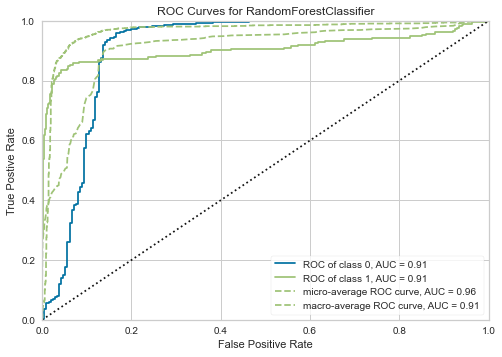

C:\Users\lette\anaconda3\lib\site-packages\sklearn\base.py:213: FutureWarning: From version 0.24, get_params will raise an AttributeError if a parameter cannot be retrieved as an instance attribute. Previously it would return None.
  FutureWarning)


ROCAUC(ax=<AxesSubplot:title={'center':'ROC Curves for RandomForestClassifier'}, xlabel='False Positive Rate', ylabel='True Postive Rate'>,
       classes=[0, 1], model=None)

In [21]:
roc_auc(clf.best_estimator_,X_train,y_train,X_test = X_cv, y_test = y_cv,classes=[0,1])

# We see a decrease in accuracy for our Random Forest Model.
# Hence our RandomForest Model with all our features provides the best results of 
## 94.7% Accuracy
## 0.97 AUC Score